## The UMAP algorithm

UMAP's algorithm is quite mathematically involved, and its mathematical underpinnings are more established than that of t-SNE's algorithm. Here, you'll just look at a simplistic overview of the algorithm; this program won't go deep into the details. If you do want to dig into the math of the algorithm, you can refer to [the original paper](https://arxiv.org/abs/1802.03426), or you can read an easier-to-follow [discussion of the algorithm](https://www.math.upenn.edu/~jhansen/2018/05/04/UMAP/).

Denote the data points as $x_1,…,x_n$. For each point, UMAP finds its $k$ nearest neighbors. Let $\sigma_i$ denote the diameter of the neighborhood of $x_i$, and let $\rho_i$ denote the distance from $x_i$ to its nearest neighbor. UMAP constructs a weighted graph from these points by doing the following:

1. For all the points $x_j$ in the k-nearest neighborhood of $x_i$, it defines the weights of the edge from $x_i$ to $x_j$ as $w_i(x_i,x_j)=exp(−(d(x_i,x_j)−\rho_i)/\sigma_i)$. Notice that according to this definition the weights from $x_i$ to $x_j$ and from $x_j$ to $x_i$ are different. In order to make them equal, UMAP modifies it to this: $w(x_i,x_j)=w_i(x_i,x_j)+w_j(x_j,x_i)−w_i(x_i,x_j)w_j(x_j,x_i)$.

2. After constructing the weighted graph, UMAP calculates the cross-entropy between two weights $w,w’$ by
$C(w,w′)=\sum\limits_{i \sim j}w(i,j)\log(\frac{w(i,j)}{w′(i,j)})+(1−w(i,j))\log(\frac{1−w(i,j)}{1−w′(i,j)})$.
Here, $w$ denotes the weights computed from the original dataset, and $w′$ denotes the weights computed from the lower-dimensional representation.

3. UMAP minimizes the total cross-entropy using an optimization method like stochastic gradient descent (SGD). This step is an iterative one and continues until convergence.

### Important points to consider

* UMAP is fast and can handle large datasets with high-dimensional data. This is its core advantage against the t-SNE method.  So, if you have a large, high-dimensional dataset that you want to visualize, you should try UMAP first instead of t-SNE. Moreover, UMAP is usually better at preserving the global structure of the data than t-SNE is. This means that it can provide a better big-picture view of your data as well as preserving local neighbor similarities.

* UMAP supports a wide variety of distance metrics, including cosine and correlation distances. Hence, the quality of the lower-dimensional representation might be affected by the metric used. You should also specify the number of neighbors and the minimum distance parameters when applying UMAP. As usual, the best way to choose values for these hyperparameters is to apply k-fold cross-validation.

### Speed

As mentioned several times before, UMAP is fast and scales well. As such, it is good at handling large, high-dimensional data. In your experiments, you may realize that UMAP can run even 20 times faster than t-SNE—especially on high-dimensional datasets like *MNIST*. And despite this runtime efficiency, UMAP still produces high-quality results.

Among the dimensionality reduction algorithms that you'll learn about in this module, PCA is the fastest, followed by UMAP. So, if you are very time constrained or your data isn't too complex, you should start with PCA. But if your data is complex, like image, text, or audio—where nonlinear relationships between the observations are the norm—then you should go with UMAP. In such a case, it's more likely that **UMAP would produce a better representation of your data than PCA would.**

## UMAP in action

At the time of writing, UMAP hasn't integrated into the scikit-learn package. So, in order to use it, you need to install it by using `pip install umap-learn` from the command line. After the installation, you can use the UMAP library by calling `import umap`. This library's API is identical to that of scikit-learn, as you'll see in a moment.

Start with importing the libraries that you'll use:

In [1]:
!pip install umap-learn
import numpy as np
import matplotlib.pyplot as plt
import time
from sklearn.datasets import fetch_openml
import umap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.9/90.9 kB 1.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.8/55.8 kB 3.3 MB/s eta 0:00:00
  Created wheel for umap-learn: filename=umap_learn-0.5.5-py3-none-any.whl size=86832 sha256=9d37cf1b3fda07cecebb60c45b2425b0eadc82406280a897c92bd6c0d56182a8
  Stored in directory: /root/.cache/pip/wheels/3a/70/07/428d2b58660a1a3b431db59b806a10da736612ebbc66c1bcc5
Successfully built umap-learn


Load the *MNIST* data using scikit-learn's `fetch_openml()` function.

**Note:** You don't have to use this method to download the *MNIST* dataset. It's [available online](http://yann.lecun.com/exdb/mnist/), so you can also download the dataset from that link and then load it in your own way. Notice that the dataset in the link is separated into two (as training and test sets), but this example will use the combined version. You can combine the training and test sets into one, or you can just use the training set. The results will look similar to each other.

If you want to use the `fetch_openml()` function and your version of scikit-learn is older than `0.20`, you can upgrade your installation by running the following code on the command line:

```bash
pip install --upgrade scikit-learn
```

Once you get the required version, you can load the *MNIST* data, as follows:

In [7]:
# Load the *MNIST* dataset below
mnist = fetch_openml('mnist_784', version=1, parser='auto', cache=True)

For the sake of comparability with the results of t-SNE, select a random subset of 10,000 of the 70,000 images. You can also run UMAP on the whole dataset and see how quickly it can get the results.

In [3]:
np.random.seed(123)

indices = np.random.choice(len(mnist.data), 10000)
X = mnist.data.loc[indices] / 255.0
y = mnist.target.loc[indices]

print(X.shape, y.shape)

(10000, 784) (10000,)


Next, you'll run the UMAP algorithm. Below, the code specifies some values for the hyperparameters of UMAP. In particular, it sets `n_neighbors=5, min_dist=0.3, metric='correlation'`. Feel free to experiment with different hyperparameter values, too.

In [4]:
time_start = time.time()

umap_results = umap.UMAP(n_neighbors=5,
                      min_dist=0.3,
                      metric='correlation').fit_transform(X)

print('UMAP done! Time elapsed: {} seconds'.format(time.time()-time_start))

UMAP done! Time elapsed: 47.86773943901062 seconds


You are all set to plot the representations that UMAP came up with. In the figure below, each data point is colored and labeled according to its true digit. This is meant to make it easier to understand how useful UMAP representations are.

In [5]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], y.iloc[i],
             color=colours[int(y.iloc[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Different digits are separated quite well, even better than t-SNE. As mentioned before, UMAP captures the global structure of the data better than t-SNE. The graph above is a clear example of this argument. If you compare this graph with the graph that was plotted using t-SNE's representation, you'll see how well different digits are placed distant from each other.

You can also observe that the data points of the same digits seem to be clustered together as they are in the t-SNE representation. The good news is that UMAP achieved this seven times faster than t-SNE did!

Now, you'll move on to the other scenario, where you don't know the true categories of the observations. Below, plot the same graph above, this time without coloring and labeling:

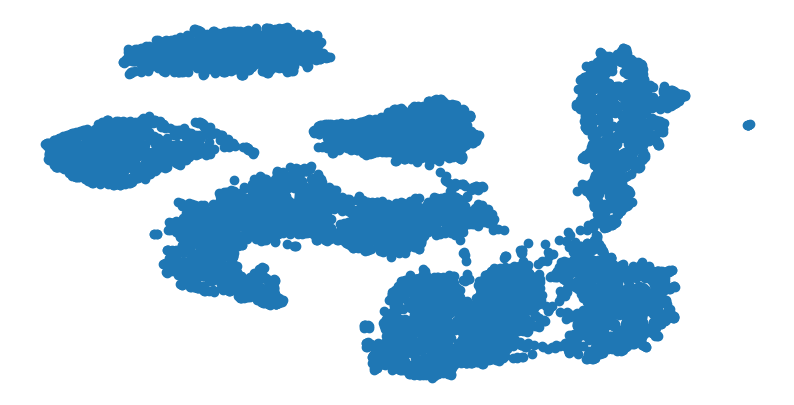

In [6]:
plt.figure(figsize=(10,5))
plt.scatter(umap_results[:, 0], umap_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

You can clearly identify nine regions in the data. Yet again, `4` and `9` are intertwined with each other and seem to be indistinguishable.

### Q1. Next, continue working with the [fashion MNIST dataset](https://github.com/zalandoresearch/fashion-mnist).

### a) Load the dataset and conduct any necessary preprocessing, such as normalizing the data.

In [8]:
mnist = fetch_openml('Fashion-MNIST', version=1, parser='auto', cache=True)

In [9]:
# Select a random subset of 10,000 images
np.random.seed(123)

indices = np.random.choice(len(mnist.data), 10000)
X = mnist.data.loc[indices] / 255.0
y = mnist.target.loc[indices]

print(X.shape, y.shape)

(10000, 784) (10000,)


### b) Apply UMAP to the data.

In [10]:
umap_results = umap.UMAP(n_neighbors=5,
                      min_dist=0.3,
                      metric='correlation').fit_transform(X)

### c) Using the two-dimensional UMAP representation, draw a graph of the data by coloring and labeling the data points.

In [11]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], y.iloc[i],
             color=colours[int(y.iloc[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### d) Do you think that the UMAP solution is satisfactory? Can you easily distinguish between the different classes? Which algorithm produced better results, UMAP or the others (t-SNE or PCA)?

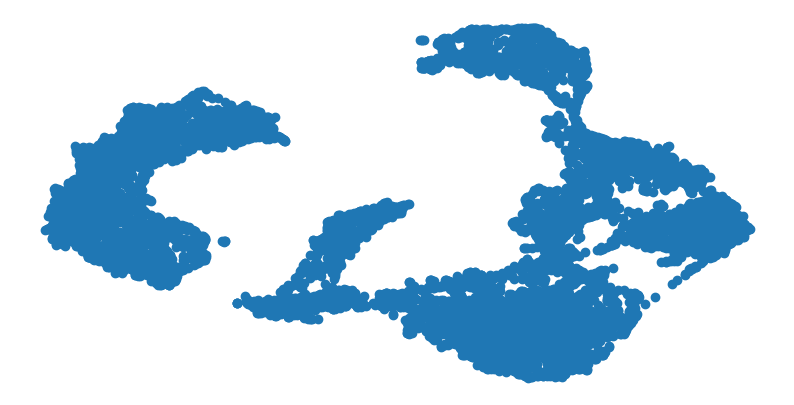

In [12]:
plt.figure(figsize=(10,5))
plt.scatter(umap_results[:, 0], umap_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

UMAP's solution is arguably better than that of PCA or t-SNE. The different classes are separated more clearly.

### e) Now, play with the different hyperparameter values of the UMAP, and apply UMAP for each of them. Which combination is the best in terms of the two-dimensional representation clarity?

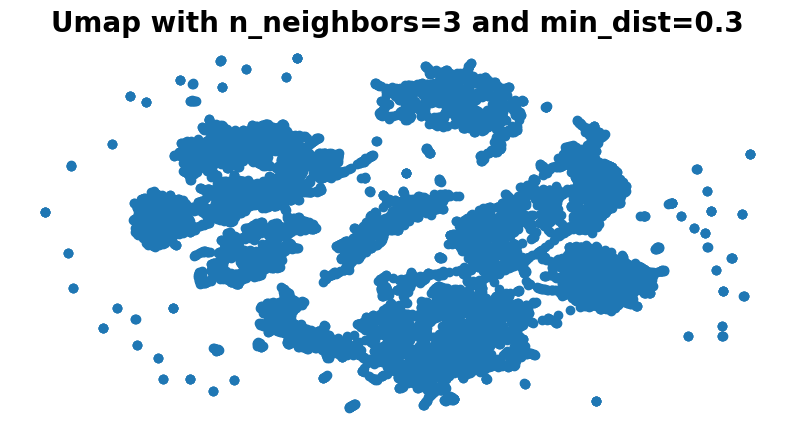

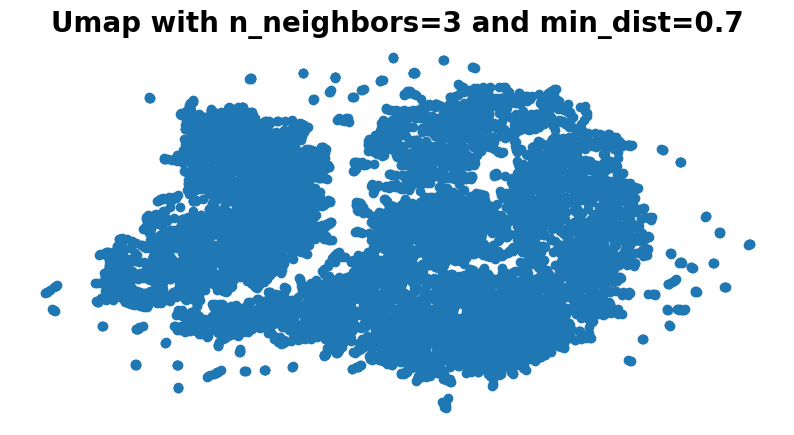

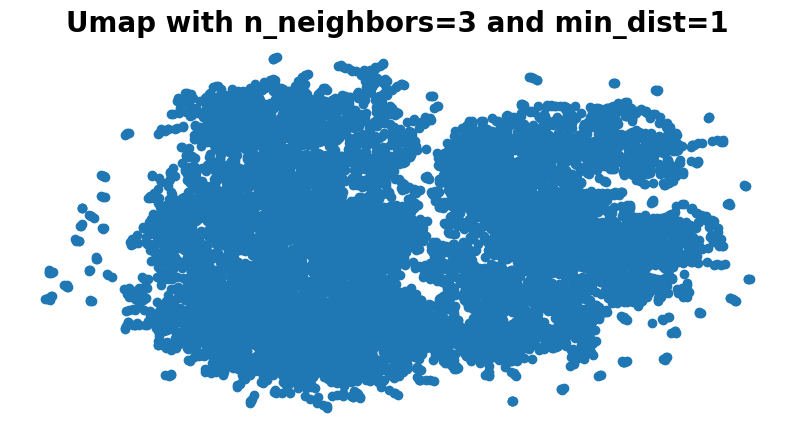

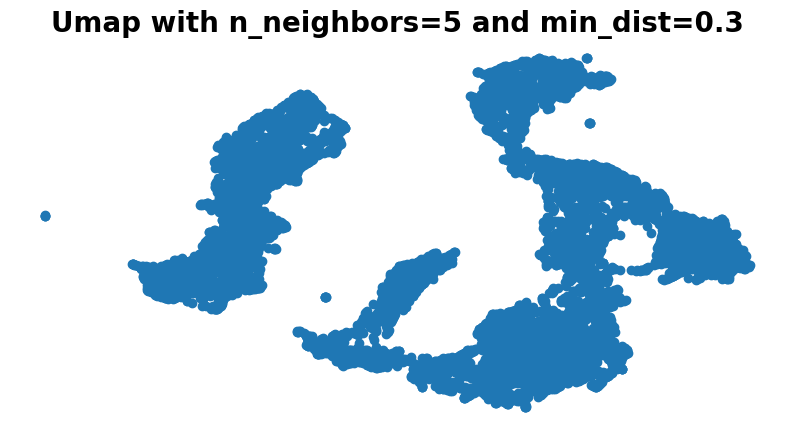

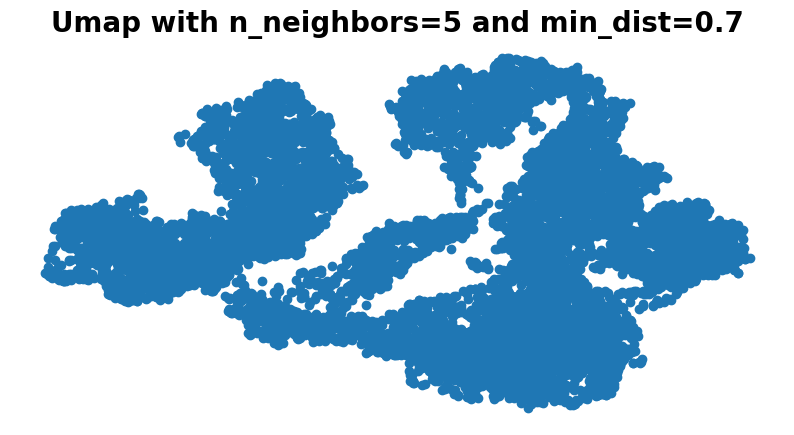

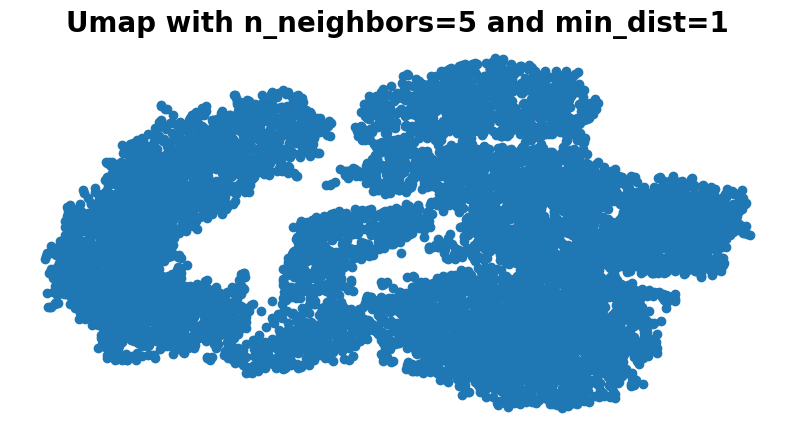

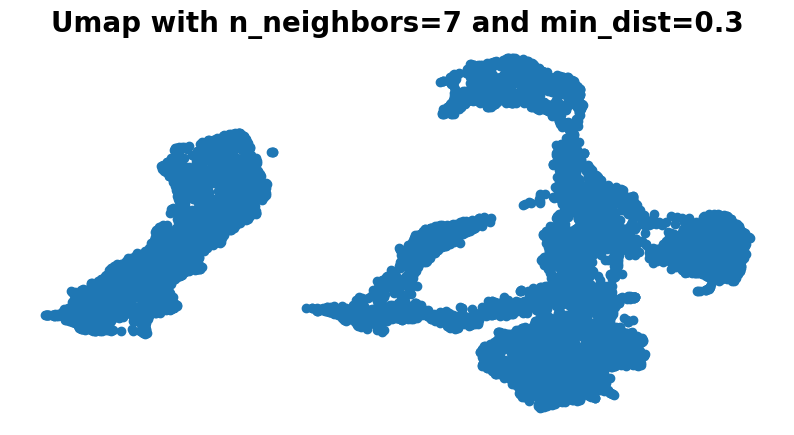

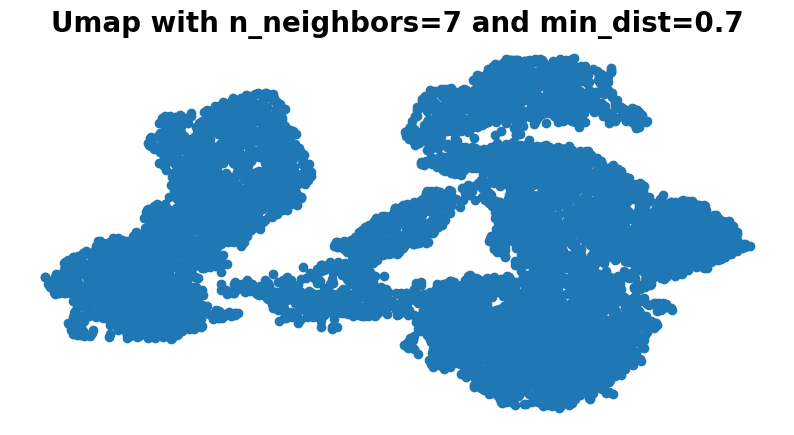

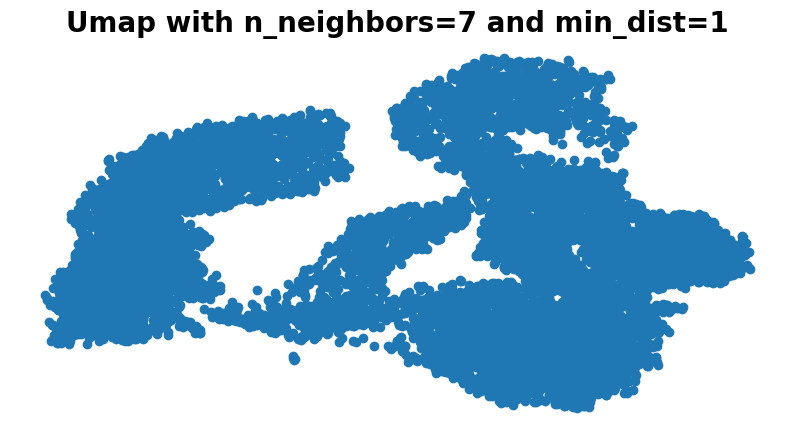

In [14]:
umap_neighbors = [3, 5, 7]
umap_dist = [0.3, 0.7, 1]

for neigh in umap_neighbors:
  for dist in umap_dist:
    umap_results = umap.UMAP(n_neighbors=neigh,
                          min_dist=dist,
                          metric='correlation').fit_transform(X)

    plt.figure(figsize=(10,5))
    plt.title("Umap with n_neighbors={} and min_dist={}".format(neigh,dist), fontdict={'weight': 'bold', 'size': 20})
    plt.scatter(umap_results[:, 0], umap_results[:, 1])
    plt.xticks([])
    plt.yticks([])
    plt.axis('off')
    plt.show()

The most promising solutions are with `n_neighbors=5`, `min_dist=0.3` and `n_neighbors=7`, `min_dist=0.3`.